In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
!git clone https://github.com/ultralytics/yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 16562, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (27/27), done.
remote: Total 16562 (delta 20), reused 29 (delta 13), pack-reused 16522
Receiving objects: 100% (16562/16562), 15.02 MiB | 15.06 MiB/s, done.
Resolving deltas: 100% (11379/11379), done.


In [ ]:
%cd /content/drive/MyDrive/yolov5

/content/drive/MyDrive/yolov5


In [ ]:
%pip install -qr requirements.txt #install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output #to display image

ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.1/74.1 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.1 MB/s eta 0:00:00


In [ ]:
#set up env

os.environ["DATASET_DIRECTORY"] ="/content/datasets"

In [ ]:


from roboflow import Roboflow
rf = Roboflow(api_key="agCPvaUrAr9Fdq0uTshE")
project = rf.workspace("cse428").project("sign-language-4mz0u")
version = project.version(2)
dataset = version.download("yolov5")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to /content/datasets/sign-language-2 in yolov5pytorch:: 100%|██████████| 164/164 [00:00<00:00, 5321.57it/s]


In [ ]:
%cat /content/datasets/sign-language-2/data.yaml

names:
- help
- thankyou
- 'yes'
nc: 3
roboflow:
  license: CC BY 4.0
  project: sign-language-4mz0u
  url: https://universe.roboflow.com/cse428/sign-language-4mz0u/dataset/2
  version: 2
  workspace: cse428
test: ../test/images
train: /content/datasets/sign-language-2/train/images
val: /content/datasets/sign-language-2/valid/images


In [ ]:
nc=3
names=["help","thankyou","yes"]

In [ ]:
!python train.py --img 416 --batch 16 --epochs 300 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

2024-04-20 16:55:14.464418: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-20 16:55:14.464480: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-20 16:55:14.465957: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/datasets/sign-language-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_sc

In [ ]:
#!python train.py --resume /content/drive/MyDrive/yolov5/runs/train/exp/weights/last.pt

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python /content/drive/MyDrive/yolov5/val.py --batch 16 --data {dataset.location}/data.yaml --weights /content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt --task test --augment

val: data=/content/datasets/sign-language-2/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=True, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=drive/MyDrive/yolov5/runs/val, name=exp, exist_ok=False, half=False, dnn=False
requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0'] not found, attempting AutoUpdate...
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.3.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 12802), started 0:58:31 ago. (Use '!kill 12802' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights /content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt --img 416 --conf 0.25 --source {dataset.location}/test/images

detect: weights=['/content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt'], source=/content/datasets/sign-language-2/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-304-g22361691 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/3 /content/datasets/sign-language-2/test/images/7thank_you_png.rf.94315ab2fd3a61e08685fe4dfba99c3c.jpg: 416x416 1 thankyou, 7.1ms
image 2/3 /content/datasets/sign-language-2/test/images/help8_jpeg.rf.c8fd21bfe6a28e6d46ebad72f67da3cd.jpg: 416x416 1 help, 7.2ms
imag

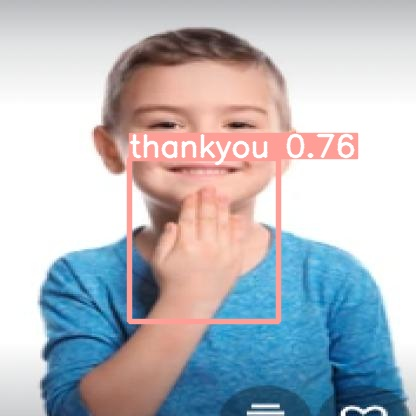

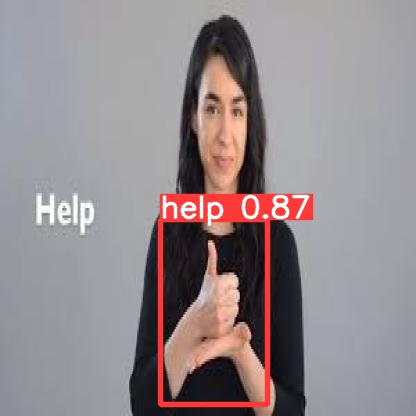

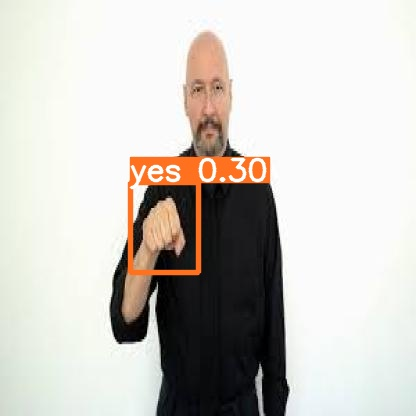

In [ ]:
import glob
from IPython.display import Image, display


for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp2/*jpg'):

    display(Image(filename=imageName))
    print("\n")


In [ ]:
from google.colab import files
files.download('/content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>